# CROCUS Lake Breeze (May 7th, 2023)

- Lake Breeze are winds that blow off of Lake Michigan on shore due to difference in temperature between the lake and the shoreline.

- While providing some relief from the heat during the Spring/Summer, these winds also can trap pollutants (in gas and particle form) at the surface creating unsafe air quality conditions.

- With an unstable atmosphere, these lake breeze circulations can also initiate convection (i.e. vertically building clouds) and produce thunderstorms as was the case on 7 May 2023. 

In [13]:
import glob
import os
import tempfile
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from math import atan2 as atan2
from datetime import datetime

from metpy.plots import USCOUNTIES
from metpy.calc import dewpoint_from_relative_humidity
from metpy.units import units
import imageio
import pyart
import nexradaws

import sage_data_client

templocation = tempfile.mkdtemp()

warnings.filterwarnings("ignore")

## <u>Define Time and Location of the Event</u>

In [2]:
DATE = "2023-05-07"
# Times must be in UTC
TIME_START = "16:00:00"
TIME_STOP = "21:00:00"
RADAR_ID = "KLOT"

In [3]:
## convert input date and time to timestamps
START = pd.Timestamp(int(DATE.split('-')[0]), 
                     int(DATE.split('-')[1]), 
                     int(DATE.split('-')[2]), 
                     int(TIME_START.split(':')[0]), 
                     int(TIME_START.split(':')[1]), 
                     int(TIME_START.split(':')[2])).tz_localize(tz="UTC")
STOP = pd.Timestamp(int(DATE.split('-')[0]), 
                    int(DATE.split('-')[1]), 
                    int(DATE.split('-')[2]), 
                    int(TIME_STOP.split(':')[0]), 
                    int(TIME_STOP.split(':')[1]), 
                    int(TIME_STOP.split(':')[2])).tz_localize(tz="UTC")

In [4]:
# Define the domain to display for Chicago
MIN_LON = -89.0
MAX_LON = -87.0
MAX_LAT = 42.5
MIN_LAT = 40.5
BOUNDING_BOX = [MIN_LON, MAX_LON, MIN_LAT, MAX_LAT]

In [5]:
# Define the CROCUS Waggle Nodes to Display
WAGGLE_SITES = {'NEIU'  : [41.980289109, -87.71703552],
                'ATMOS' : [41.701605152, -87.995196552]
               }

## <u>Define Helper Functions</u>

In [6]:
def gc_latlon_bear_dist(lat1, lon1, bear, dist):
    """
    Input lat1/lon1 as decimal degrees, as well as bearing and distance from
    the coordinate. Returns lat2/lon2 of final destination. Cannot be
    vectorized due to atan2.
    """
    re = 6371.1  # km
    lat1r = np.deg2rad(lat1)
    lon1r = np.deg2rad(lon1)
    bearr = np.deg2rad(bear)
    lat2r = np.arcsin(
        (np.sin(lat1r) * np.cos(dist / re))
        + (np.cos(lat1r) * np.sin(dist / re) * np.cos(bearr))
    )
    lon2r = lon1r + atan2(
        np.sin(bearr) * np.sin(dist / re) * np.cos(lat1r),
        np.cos(dist / re) - np.sin(lat1r) * np.sin(lat2r),
    )
    return np.rad2deg(lat2r), np.rad2deg(lon2r)

def add_scale_line(
    scale, ax, projection, color="k", linewidth=None, fontsize=None, fontweight=None
):
    """
    Adds a line that shows the map scale in km. The line will automatically
    scale based on zoom level of the map. Works with cartopy.

    Parameters
    ----------
    scale : scalar
        Length of line to draw, in km.
    ax : matplotlib.pyplot.Axes instance
        Axes instance to draw line on. It is assumed that this was created
        with a map projection.
    projection : cartopy.crs projection
        Cartopy projection being used in the plot.

    Other Parameters
    ----------------
    color : str
        Color of line and text to draw. Default is black.
    """
    frac_lat = 0.15  # distance fraction from bottom of plot
    frac_lon = 0.35  # distance fraction from left of plot
    e1 = ax.get_extent()
    center_lon = e1[0] + frac_lon * (e1[1] - e1[0])
    center_lat = e1[2] + frac_lat * (e1[3] - e1[2])
    # Main line
    lat1, lon1 = gc_latlon_bear_dist(
        center_lat, center_lon, -90, scale / 2.0
    )  # left point
    lat2, lon2 = gc_latlon_bear_dist(
        center_lat, center_lon, 90, scale / 2.0
    )  # right point
    if lon1 <= e1[0] or lon2 >= e1[1]:
        warnings.warn(
            "Scale line longer than extent of plot! "
            + "Try shortening for best effect."
        )
    ax.plot(
        [lon1, lon2],
        [lat1, lat2],
        linestyle="-",
        color=color,
        transform=projection,
        linewidth=linewidth,
    )
    # Draw a vertical hash on the left edge
    lat1a, lon1a = gc_latlon_bear_dist(
        lat1, lon1, 180, frac_lon * scale / 20.0
    )  # bottom left hash
    lat1b, lon1b = gc_latlon_bear_dist(
        lat1, lon1, 0, frac_lon * scale / 20.0
    )  # top left hash
    ax.plot(
        [lon1a, lon1b],
        [lat1a, lat1b],
        linestyle="-",
        color=color,
        transform=projection,
        linewidth=linewidth,
    )
    # Draw a vertical hash on the right edge
    lat2a, lon2a = gc_latlon_bear_dist(
        lat2, lon2, 180, frac_lon * scale / 20.0
    )  # bottom right hash
    lat2b, lon2b = gc_latlon_bear_dist(
        lat2, lon2, 0, frac_lon * scale / 20.0
    )  # top right hash
    ax.plot(
        [lon2a, lon2b],
        [lat2a, lat2b],
        linestyle="-",
        color=color,
        transform=projection,
        linewidth=linewidth,
    )
    # Draw scale label
    ax.text(
        center_lon,
        center_lat - frac_lat * (e1[3] - e1[2]) / 4.0,
        str(int(scale)) + " km",
        horizontalalignment="center",
        verticalalignment="center",
        color=color,
        fontweight=fontweight,
        fontsize=fontsize,
    )

## <u>Create Display Function to Display CROCUS Domain</u>

In [7]:
def chicago_aq_display(nradar, bounds, sites, aqvals, rad_time, rad_site='KLOT', **kwargs):
    #---------------------------------------------------
    # Define the GridSpec for Detailed Subplot Placement
    #---------------------------------------------------
    fig = plt.figure(figsize=(16, 10))

    gs0 = gridspec.GridSpec(1, 2, figure=fig)
    gs00 = gs0[1].subgridspec(4, 1, hspace=0.9, wspace=0.85)

    # update the extent of the subplot
    gs0.update(top=.90, bottom=0.1, left=0.1, right=.99)

    #-------------------
    # Plot the Radar PPI
    #-------------------
    ax1 = fig.add_subplot(gs0[0], projection=ccrs.PlateCarree())

    ax1.add_feature(cfeature.STATES, linewidth=3)
    ax1.add_feature(USCOUNTIES, alpha=0.4)

    # Create the Radar Display Object
    display = pyart.graph.RadarMapDisplay(nradar)

    # Plot the reflectivty
    display.plot_ppi_map('reflectivity', 
                         ax=ax1,
                         sweep=3, 
                         vmin=-20,
                         vmax=45,
                         lat_lines=None,
                         lon_lines=None,
                         min_lat=bounds[2],
                         max_lat=bounds[3],
                         min_lon=bounds[0],
                         max_lon=bounds[1],
                         ticklabs='',
                         embellish=False,
                         norm=None,
                         cmap="Spectral_r")
    
    # Add the scale line
    add_scale_line(10, ax1, ccrs.PlateCarree())

    # Add the locations of the waggle nodes
    for nsite in sites:
        ax1.scatter(sites[nsite][1], sites[nsite][0], s=60, marker='d', label=nsite)
    # Add a legend
    plt.legend(loc='upper left',
               fontsize=12)
    
    #-------------------------------------------
    # Add the air quality transmitter (AQT) data
    #-------------------------------------------
    ## Note: I am using the radar scan time to time sync the AQT and radar data
    aq_temp = aqvals.loc['2023-05-07 16:00:00':rad_time]
    # Add the second plot for the gridspec
    axs2 = fig.add_subplot(gs00[0])
    aq_temp['pm1.0'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                          ylabel='Part Matter ug/m3',
                          title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                          ax=axs2, 
                          color='r', 
                          label='PM1.0',
                          )

    aq_temp['pm2.5'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                          ylabel='Part Matter ug/m3',
                          title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                          ax=axs2, 
                          color='g', 
                          label='PM2.5',
                         )

    aq_temp['pm10.0'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                           ylabel='Part Matter ug/m3',
                           title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                           ax=axs2, 
                           color='b', 
                           label='PM10.0',
                          )

    axs2.legend()
    axs2.grid(True)
    # Note: force the axis to display the entire time range
    axs2.set_xlim([DATE + ' ' + TIME_START, DATE + ' ' + TIME_STOP])
    #axs2.set_ylim([0.0, 0.3])

    axs3 = fig.add_subplot(gs00[1])
    (aq_temp['co']/10.0).plot(xlabel='UTC Time \n [HH:MM:SS]',
                              ylabel='Molecules of per million',
                              title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                              ax=axs3, 
                              color='b', 
                              label='CO/10',
                             )

    aq_temp['no'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                       ylabel='Molecules of per million',
                       title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                       ax=axs3, 
                       color='g', 
                       label='NO',
                      )


    aq_temp['no2'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                        ylabel='Molecules of per million',
                        title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                        ax=axs3, 
                        color='r', 
                        label='NO2',
                       )


    aq_temp['o3'].plot(xlabel='UTC Time \n [HH:MM:SS]',
                       ylabel='Molecules of per million',
                       title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                       ax=axs3, 
                       color='purple', 
                       label='o3',
                      )
    axs3.legend()
    axs3.grid(True)
    axs3.set_xlim([DATE + ' ' + TIME_START, DATE + ' ' + TIME_STOP])
    axs3.set_ylim([0.0, 0.05])

    axs4 = fig.add_subplot(gs00[2])
    aq_temp.temp.plot(xlabel='UTC Time \n [HH:MM:SS]',
                      ylabel='Ambient Temperature \n [Degree Celsius]',
                      title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                      ax=axs4, color='r', label='Dry Bulb',
                     )

    aq_temp.dewpoint.plot(xlabel='UTC Time \n [HH:MM:SS]',
                          ylabel='Ambient Temperature \n [Degree Celsius]',
                          title='CROCUS NEIU Node (W08D) - Vaisala AQT530',
                          color='b', label='Dew Point',
                          ax=axs4
                         )

    axs4.legend()
    axs4.grid(True)
    axs4.set_xlim([DATE + ' ' + TIME_START, DATE + ' ' + TIME_STOP])
    #axs4.set_ylim([0.0, 0.3])

    # Search to see if temporary directory was supplied to save the file
    if kwargs['templocation']:
        plt.savefig(kwargs['templocation'] + '/' + 'lakebreeze' + '_' + rad_site + '_' + str(rad_time) +'.png')
    else:
        plt.savefig('lakebreeze' + '_' + rad_site + '_' + str(rad_time) +'.png')


## <u>Data Query</u>

### [National Weather Service Radar - Romoville, IL (KLOT)](https://radar.weather.gov/station/klot/standard)

- The National Weather Service Next Generation Radar (NEXRAD) in Romoville, IL provides radar coverage for the Chicago Region, allowing meteorologists to understand potential weather hazards (severe storms).
  
- We show how to query data from this station and create a phase plane indictator (PPI) movie for the events of the user's desire

- This will allow us to investigate meteorological events within the region and compare against our CROCUS Nodes

In [8]:
# Configure the nexrad interface using our time and location
conn = nexradaws.NexradAwsInterface()
scans = conn.get_avail_scans_in_range(START, STOP, RADAR_ID)
print("There are {} scans available between {} and {}\n".format(len(scans), START, STOP))

# Download the files
results = conn.download(scans, templocation)

There are 48 scans available between 2023-05-07 16:00:00+00:00 and 2023-05-07 21:00:00+00:00

Downloaded KLOT20230507_163235_V06
Downloaded KLOT20230507_162536_V06
Downloaded KLOT20230507_161027_V06
Downloaded KLOT20230507_160329_V06
Downloaded KLOT20230507_163934_V06
Downloaded KLOT20230507_161726_V06
Downloaded KLOT20230507_165332_V06_MDM
Downloaded KLOT20230507_164633_V06
Downloaded KLOT20230507_165332_V06
Downloaded KLOT20230507_170031_V06
Downloaded KLOT20230507_171428_V06
Downloaded KLOT20230507_170729_V06
Downloaded KLOT20230507_172127_V06
Downloaded KLOT20230507_175622_V06_MDM
Downloaded KLOT20230507_172827_V06
Downloaded KLOT20230507_173525_V06
Downloaded KLOT20230507_174224_V06
Downloaded KLOT20230507_174923_V06
Downloaded KLOT20230507_175622_V06
Downloaded KLOT20230507_180321_V06
Downloaded KLOT20230507_181020_V06
Downloaded KLOT20230507_181719_V06
Downloaded KLOT20230507_183117_V06
Downloaded KLOT20230507_182419_V06
Downloaded KLOT20230507_183817_V06
Downloaded KLOT20230507

### [CROCUS Level 3 Node Data Query (W08D)](https://portal.sagecontinuum.org/node/W08D) - Northeastern Illinois University
- Please check our notebooks on the [CROCUS-Level1-Node](https://crocus-urban.github.io/instrument-cookbooks/notebooks/crocus_level1_node/vaisala_wxt536.html) for more information on data query with the SAGE Data Client

- Northeastern Illinois University (NEIU) served as the first CROCUS node deployed to the Chicago region. 

In [9]:
## NEIU AQT 
df_aq = sage_data_client.query(start = DATE + 'T' + TIME_START + 'Z',
                               end = DATE + 'T' + TIME_STOP + 'Z', 
                               filter={
                                        "plugin": "registry.sagecontinuum.org/jrobrien/waggle-aqt:0.23.5.*",
                                       }
)

# extract the particle measurements from the DataFrame
pm25 = df_aq[df_aq['name']=='aqt.particle.pm2.5']
pm10 = df_aq[df_aq['name']=='aqt.particle.pm1']
pm100 = df_aq[df_aq['name']=='aqt.particle.pm10']

# extract the gas measurements from the DataFrame
no = df_aq[df_aq['name']=='aqt.gas.no']
o3 = df_aq[df_aq['name']=='aqt.gas.ozone']
no2 = df_aq[df_aq['name']=='aqt.gas.no2']
co = df_aq[df_aq['name']=='aqt.gas.co']

# extract the environment data from the DataFrame
aqtemp = df_aq[df_aq['name']=='aqt.env.temp']
aqhum = df_aq[df_aq['name']=='aqt.env.humidity']

# Convert values to numpy arrays
aqvals = pm25.set_index('timestamp')
aqvals['pm2.5'] = aqvals.value.to_numpy().astype(float)
aqvals['pm1.0'] = pm10.value.to_numpy().astype(float)
aqvals['pm10.0'] = pm100.value.to_numpy().astype(float)
aqvals['no'] = no.value.to_numpy().astype(float)
aqvals['o3'] = o3.value.to_numpy().astype(float)
aqvals['no2'] = no2.value.to_numpy().astype(float)
aqvals['co'] = co.value.to_numpy().astype(float)
aqvals['temp'] =  aqtemp.value.to_numpy().astype(float)
aqvals['hum'] =  aqhum.value.to_numpy().astype(float)

# Use MetPY to calculate dewpoint from temperature and relative humidity
dp = dewpoint_from_relative_humidity( aqvals.temp.to_numpy() * units.degC, 
                                     aqvals.hum.to_numpy() * units.percent)

aqvals['dewpoint'] = dp

## <u>Create Display</u>

- Loop over each radar file and plot corresponding AQT data for that volume
- We use the [Python ARM Radar Toolkit (Py-ART)](https://arm-doe.github.io/pyart/) to open and display the data

working on KLOT20230507_161027_V06
working on KLOT20230507_161726_V06
working on KLOT20230507_162536_V06
working on KLOT20230507_163235_V06
working on KLOT20230507_163934_V06
working on KLOT20230507_164633_V06
working on KLOT20230507_165332_V06
working on KLOT20230507_170031_V06
working on KLOT20230507_170729_V06
working on KLOT20230507_171428_V06
working on KLOT20230507_172127_V06
working on KLOT20230507_172827_V06
working on KLOT20230507_173525_V06
working on KLOT20230507_174224_V06
working on KLOT20230507_174923_V06
working on KLOT20230507_175622_V06
working on KLOT20230507_180321_V06
working on KLOT20230507_181020_V06
working on KLOT20230507_181719_V06
working on KLOT20230507_182419_V06
working on KLOT20230507_183117_V06
working on KLOT20230507_183817_V06
working on KLOT20230507_184517_V06
working on KLOT20230507_185217_V06
working on KLOT20230507_185917_V06
working on KLOT20230507_190617_V06
working on KLOT20230507_191316_V06
working on KLOT20230507_192015_V06
working on KLOT20230

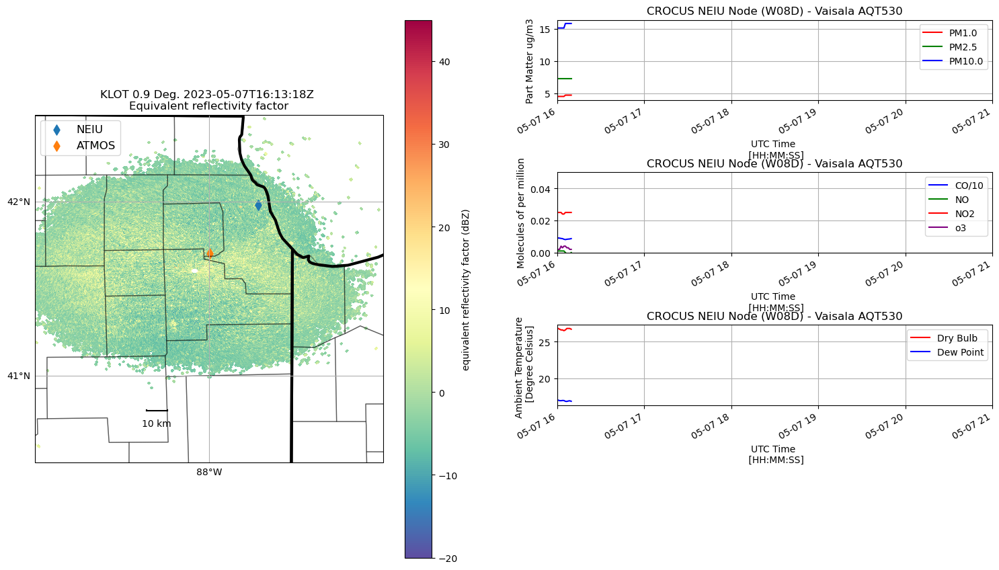

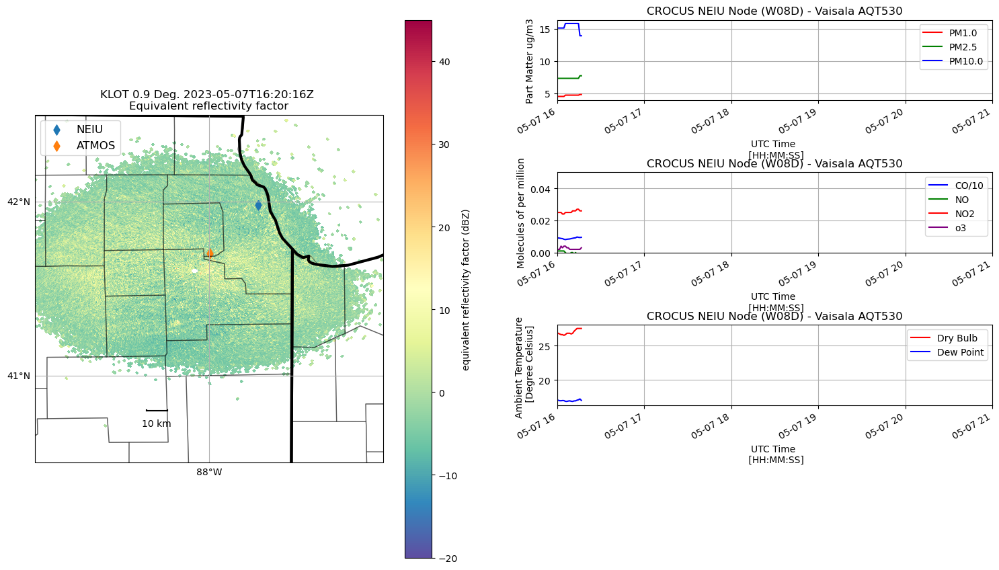

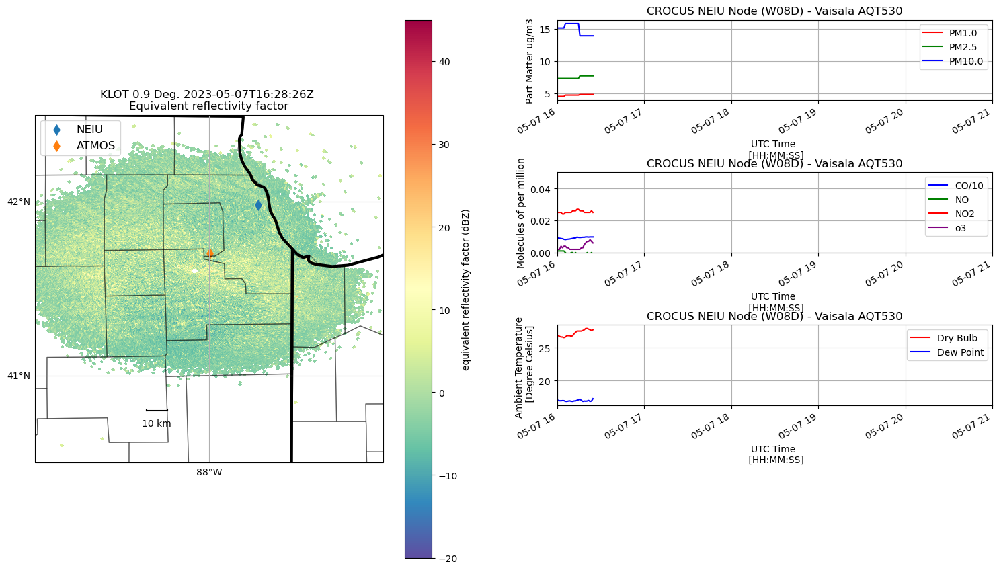

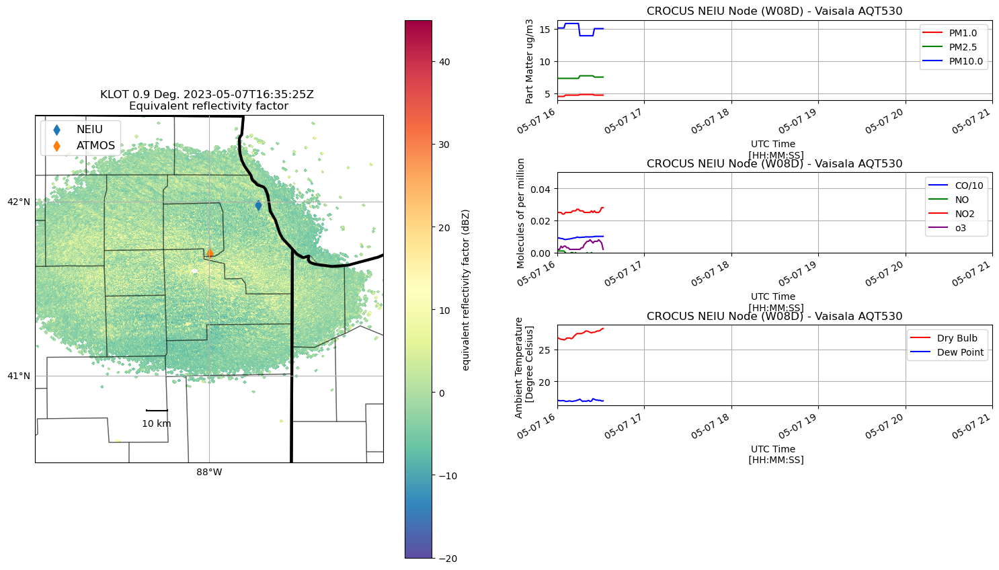

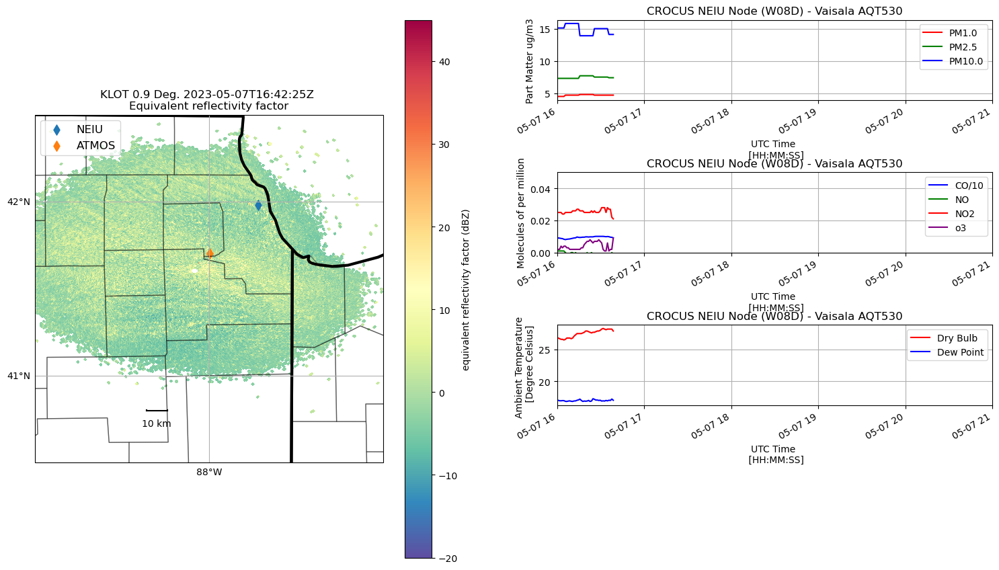

...

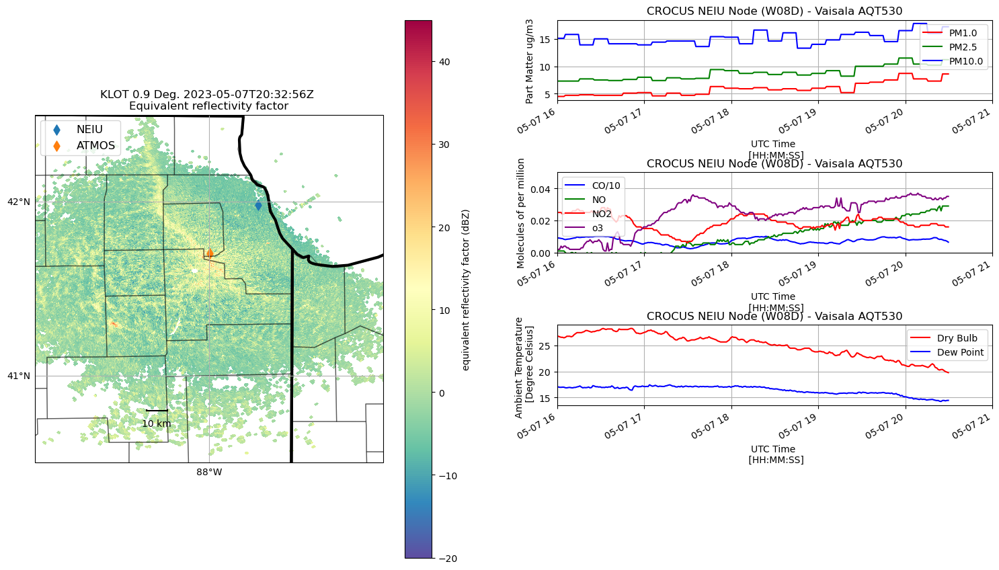

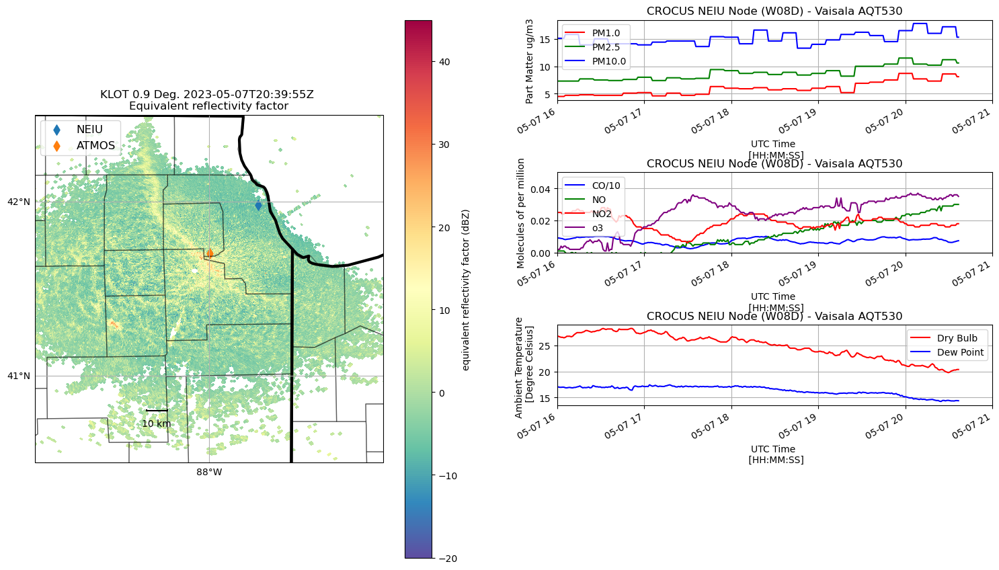

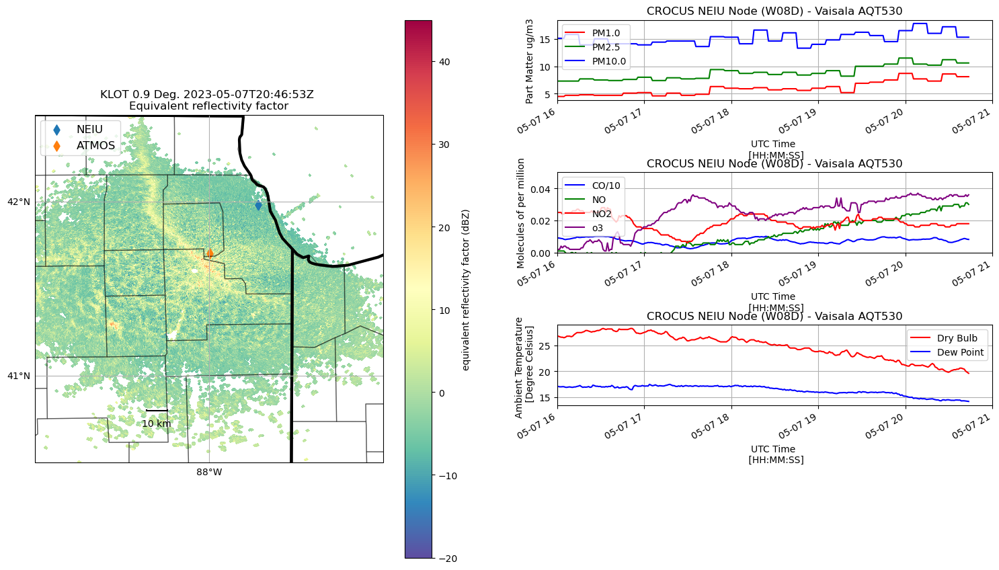

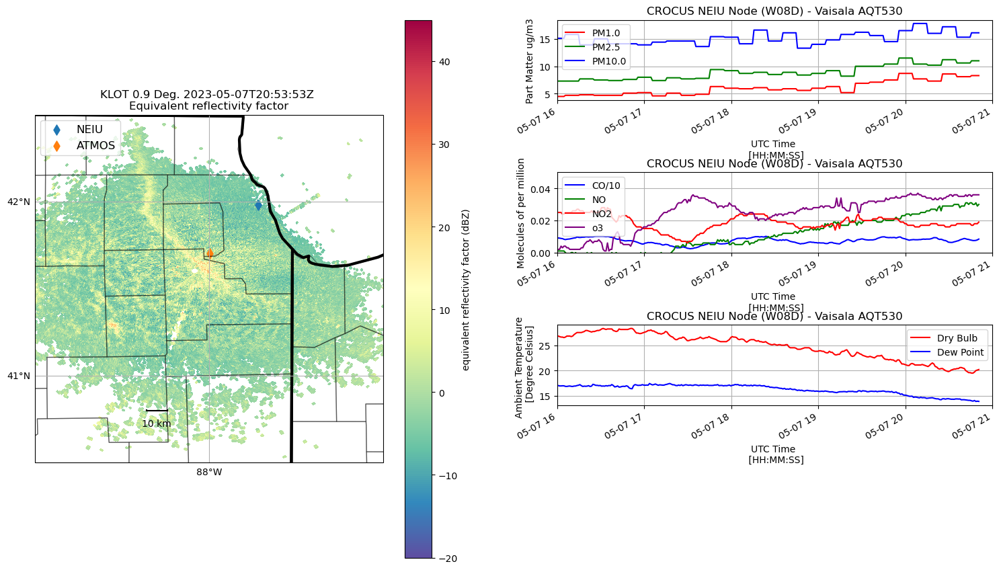

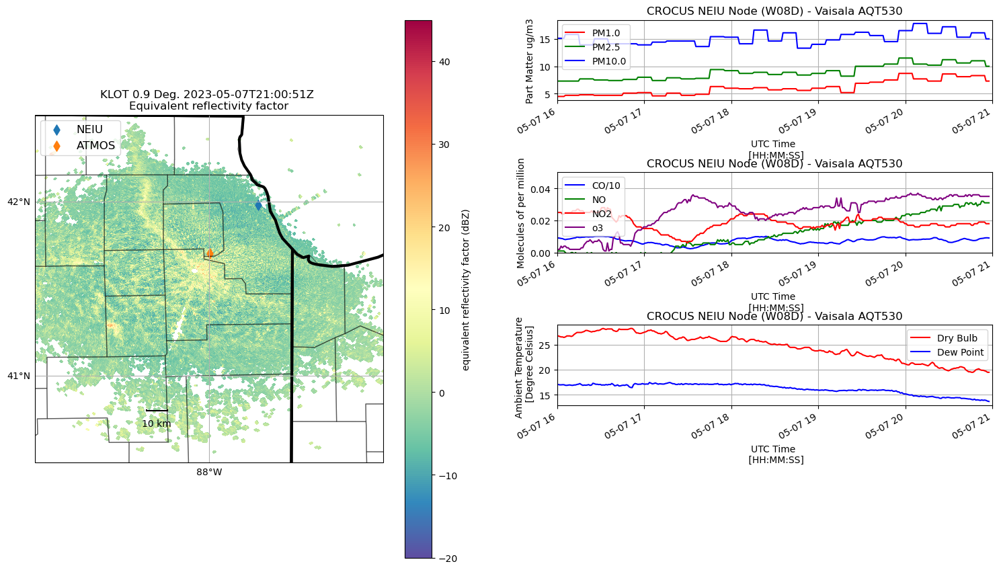

In [10]:
for i, scan in enumerate(results.iter_success(), start=1):
    ## skip the files ending in "MDM"
    if scan.filename[-3:] != "MDM":
        if i > 1:
            # define what file you are working on
            print("working on " + scan.filename)
            # define the radar time
            rad_time = scan.filename[4:8] + '-' + scan.filename[8:10] + '-' + scan.filename[10:12] + \
                       ' ' + scan.filename[13:15] + ':' + scan.filename[15:17] + ':' + scan.filename[17:19]
            # Open the file with PyART
            radar = scan.open_pyart()
            # Call the CROCUS AQ Display Function
            chicago_aq_display(radar, 
                               BOUNDING_BOX, 
                               WAGGLE_SITES, 
                               aqvals, 
                               rad_time,
                               templocation=templocation)
            # close the radar file
            del radar

## <u>Assemble Static Plots into a Movie</u>

In [11]:
# Define files created and define movie path
map_images = sorted(glob.glob(templocation + f"/lakebreeze*"))
gif_title = f"lakebreeze_{RADAR_ID}-map-animation.gif"

# Check to see if the file exists - if it does, delete it
if os.path.exists(gif_title):
    os.remove(gif_title)

# Loop through and create the gif
with imageio.get_writer(gif_title, mode='I', duration=0.2) as writer:
    for filename in map_images:
        image = imageio.imread(filename)
        writer.append_data(image)

![SegmentLocal](lakebreeze_KLOT-map-animation.gif "segment")